# Step 1: Load data into dataframe

In [1]:
# from simiclass.data import load_10x_dataset, load_GSE_dataset
# p2data = <>
p2df = '/data/jianhao/hepatocyte_update_dataset_101619/magic_cell_mat_w_label_pd'

p2assignment = '/data/jianhao/hepatocyte_update_dataset_101619/hepa_assignment_PA249'
### [TODO] label_to_int = {cell_states: integer}
# load_dataset(p2data, p2df, p2fc, p2assignment)
p2label_convert_dict = '/data/jianhao/hepatocyte_update_dataset_101619/label_to_integer_dict_pickle'

label_to_int = {'PN14': 0,
               'Adult': 1,
               'PHx24': 2,
               'PHx48': 3,
               'PHx96': 4}
import pickle
with open(p2label_convert_dict, 'wb') as f:
    pickle.dump(label_to_int, f)

# Step 2: Perform simicLASSO and save weights

In [2]:
# from simiclasso.clus_regression import simicLASSO_op

k_cluster = 5
similarity = True
p2tf = '/home/jianhao2/simicLASSO_git/data/diff_gene_list/TF_ids_human_protein_atlas_pickle'
p2saved_file = '/data/jianhao/200TF_1000Target_w_r2_stderror_NF_100_l1e-2_l2e-5'
num_target_genes = 1000
num_TFs = 200

# num_rep = [number of repeated experiments]
# max_rcd_iter = 500000 # by default
# simicLASSO_op(p2df, p2fc, p2assignment, k_cluster, 
#     similarity, p2tf, p2saved_file, num_target_genes, gene_list_type,
#     num_rep, max_rcd_iter)

# Step 3: Evaluate weights and derived GRNs

In [3]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
import numpy as np
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [4]:
# p2saved_file = '/data/jianhao/hepatocyte_update_dataset_101619/magic_data_True_similarity_1000_target'
# p2saved_file = '/data/jianhao/updated_dict_w_std_and_r2_pickle'
with open(p2saved_file, 'rb') as f:
    results_all = pickle.load(f)
    
results_all.keys()

dict_keys(['weight_dic', 'adjusted_r_squared', 'standard_error', 'TF_ids', 'query_targets'])

In [ ]:
results_all['weight_dic'].keys()

In [ ]:
weight_dic = results_all['weight_dic']
TF_ids = results_all['TF_ids']
target_ids = results_all['query_targets']
print('length of TF: ',len(TF_ids))

for label in weight_dic:
    print(weight_dic[label].shape)
    break

In [ ]:
# print(weight_dic)

In [ ]:
def invert_dict(in_dict):
    out_dict = {}
    for k in in_dict.keys():
        val = in_dict[k]
        out_dict[val] = k
    return out_dict

with open(p2label_convert_dict, 'rb') as f:
    label2int_dict = pickle.load(f)

int2label_dict = invert_dict(label2int_dict)

# AUCell -- [outdated, use script to run instead]

In [ ]:
import pandas as pd

In [ ]:
original_df = pd.read_pickle(p2df)
original_df.columns = map(str.upper, original_df.columns)
original_df

In [ ]:
# step 1: normalized weight matrix by target expression.
print(target_ids[:3])
print(weight_dic[0].shape)

target_df = original_df[target_ids]
target_norms = np.linalg.norm(target_df, axis = 0)

In [ ]:
normalized_weights = {}
for label in weight_dic:
    normalized_mat = weight_dic[label] / target_norms
    normalized_weights[label] = normalized_mat[:len(TF_ids), :]
print(normalized_weights[0].shape)

In [ ]:
# verified target expression normalization.
# a = np.array([[4, 2, 3], [8, 4, 6], [2, 1, 1.5]])
# b = [4, 2, 3]
# a / b

### array([[1. , 1. , 1. ],
###        [2. , 2. , 2. ],
###        [0.5, 0.5, 0.5]])

In [ ]:
def cal_AUC(row_series_in, weight_series_in):
    df_new = pd.concat([row_series_in, row_series_in], axis = 1).T
    df_new = df_new.reset_index(drop = True)
    df_new.loc[1] = weight_series_in
    df_new.fillna(0)
#     ipdb.set_trace()
    df_sorted_by_row = df_new.sort_values(axis = 1, by = 0, ascending = False)
    len_of_genes = len(weight_series_in)
    running_sum = [np.sum(df_sorted_by_row.loc[1].values[:x+1]) for x in range(len_of_genes)]
    AUC_score = np.sum(running_sum) / (np.sum(weight_series_in) * len_of_genes)
    return AUC_score
    
    
    
def get_AUCell_mat(original_df, weight_dict, TF_ids, target_ids, threshold = None):
    '''
    weight_mat: # num_TFs * num_Targets.
    target_ids: all targets, thresholding should only change the value to 0, not removing.
    '''
    df_in = original_df.reset_index(drop = True)
    original_index = original_df.index
    AUC_dict = {}
    for label in weight_dict:
        weight_mat = np.abs(weight_dict[label])
        AUC_mat = np.zeros([df_in.shape[0], len(TF_ids)])
        for row in df_in.iterrows():
            tmp_AUC_row = np.zeros(len(TF_ids))
            row_idx = row[0]
            row_series_in = row[1][:len(TF_ids)]
            for tf_idx in range(len(TF_ids)):
                weight_series_in = pd.Series(data = weight_mat[tf_idx, :], index = target_ids)
                AUC_score = cal_AUC(row_series_in, weight_series_in)
                tmp_AUC_row[tf_idx] = AUC_score
            AUC_mat[row_idx, :] = tmp_AUC_row
            
        AUC_dict[label] = pd.DataFrame(data=AUC_mat, columns = TF_ids, index=original_index)
    
    return AUC_dict

In [ ]:
AUC_dict = get_AUCell_mat(original_df, normalized_weights, TF_ids, target_ids)

In [ ]:
AUC_dict

# Draw histogram and see states transition

In [5]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [6]:
p2AUC_dict = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_hepa_monoc_states'
with open(p2AUC_dict, 'rb') as f:
    AUC_dict = pickle.load(f)
print(AUC_dict.keys())
AUC_dict[1]

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9])


,NCOA2,STAT1,LRRFIP1,HES6,ELK4,NR5A2,ATF6,NR1I3,PROX1,IRF6,...,CXXC1,MBD1,TSHZ1,KDM2A,RELA,ZFP91,KLF9,HHEX,MXI1,TCF7L2
PN14_AAACCCAAGAAATGGG,0.469232,0.470952,0.454461,0.487105,0.461046,0.448823,0.457934,0.456745,0.471252,0.479623,...,0.474116,0.440644,0.476197,0.459513,0.474296,0.480134,0.462091,0.473554,0.492261,0.465211
PN14_AAACCCAAGCTGAGTG,0.466252,0.464435,0.463276,0.477006,0.447747,0.428467,0.455103,0.435071,0.461467,0.479215,...,0.463489,0.443502,0.459059,0.450397,0.463970,0.457979,0.464821,0.470030,0.477689,0.455479
PN14_AAACCCACAACGTTAC,0.463755,0.466424,0.462978,0.482318,0.450950,0.429347,0.458030,0.435205,0.457974,0.474159,...,0.468354,0.444258,0.461274,0.453807,0.463955,0.456234,0.466816,0.480702,0.482550,0.457440
PN14_AAACCCAGTGCAATAA,0.466210,0.464414,0.463283,0.476985,0.447760,0.428497,0.455153,0.435060,0.461527,0.479176,...,0.463510,0.443505,0.458978,0.450368,0.463972,0.457948,0.464834,0.470017,0.477664,0.455486
PN14_AAACCCAGTGCTCCGA,0.464476,0.465817,0.462876,0.480269,0.450652,0.430300,0.454765,0.435785,0.460001,0.479086,...,0.466840,0.442018,0.459887,0.451598,0.468432,0.457349,0.466105,0.473361,0.479770,0.453628
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PHx96_TTTGGTTGTACCCGAC,0.465428,0.468995,0.468687,0.475353,0.461140,0.458470,0.469335,0.462568,0.460564,0.465459,...,0.456438,0.463032,0.453607,0.458201,0.473370,0.463636,0.466445,0.482598,0.451667,0.472029
PHx96_TTTGGTTTCCAGTGTA,0.473498,0.469467,0.458485,0.482501,0.461630,0.444942,0.461073,0.455626,0.473048,0.478671,...,0.462734,0.457563,0.476796,0.472691,0.473340,0.473756,0.485945,0.482644,0.461439,0.469551
PHx96_TTTGGTTTCCATGATG,0.471719,0.471071,0.466929,0.482573,0.459615,0.448676,0.458220,0.453759,0.472376,0.476060,...,0.463365,0.459830,0.475738,0.475413,0.472385,0.475221,0.484963,0.478107,0.462365,0.471838
PHx96_TTTGTTGCAAGCTACT,0.446925,0.446836,0.450449,0.461142,0.449889,0.450495,0.453167,0.468187,0.466108,0.441474,...,0.447941,0.463059,0.459723,0.463390,0.475761,0.439031,0.479665,0.479876,0.447834,0.467175


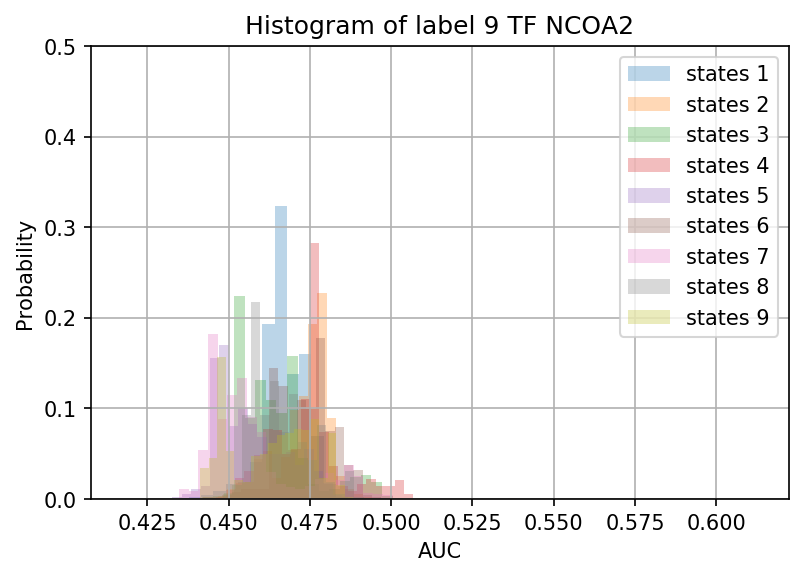

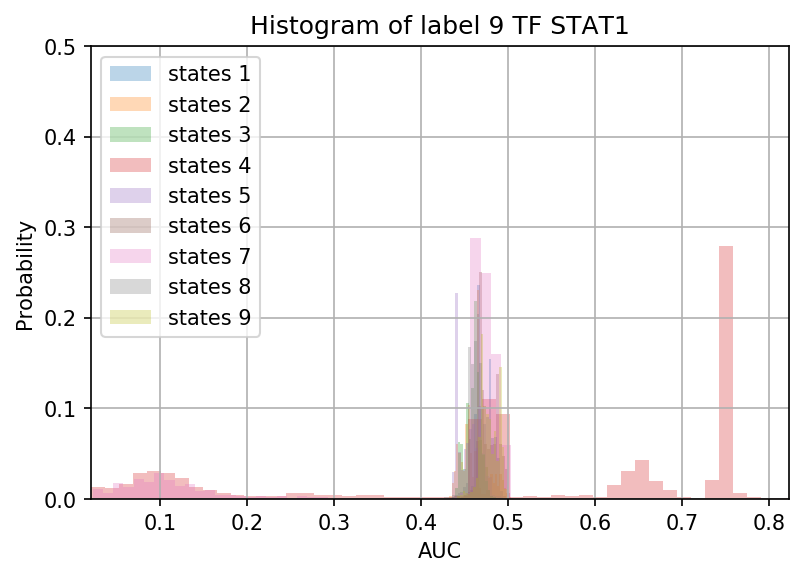

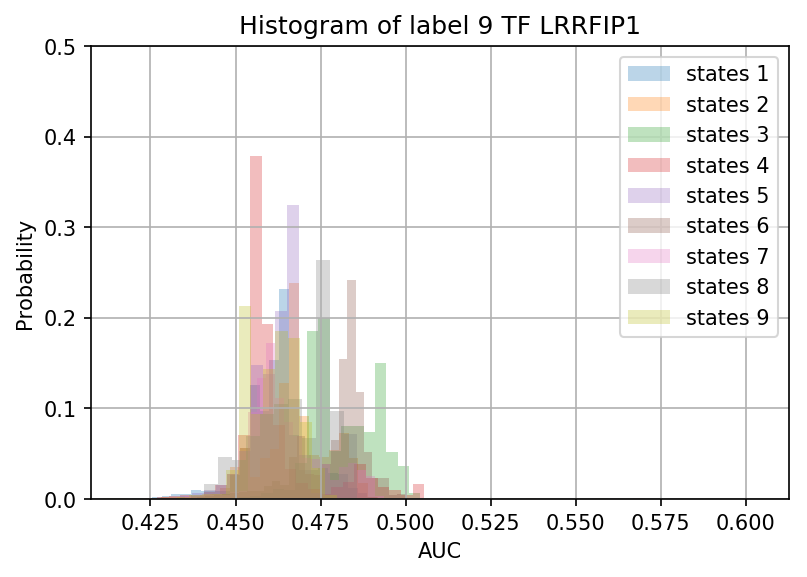

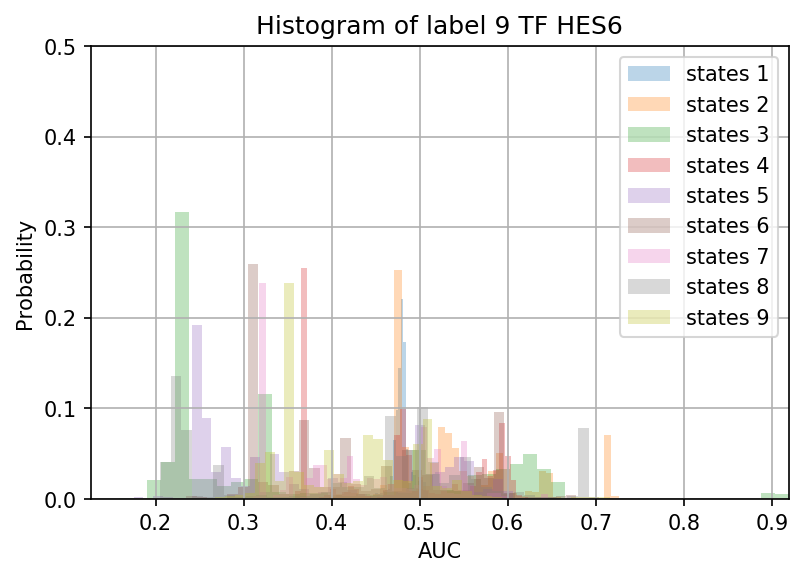

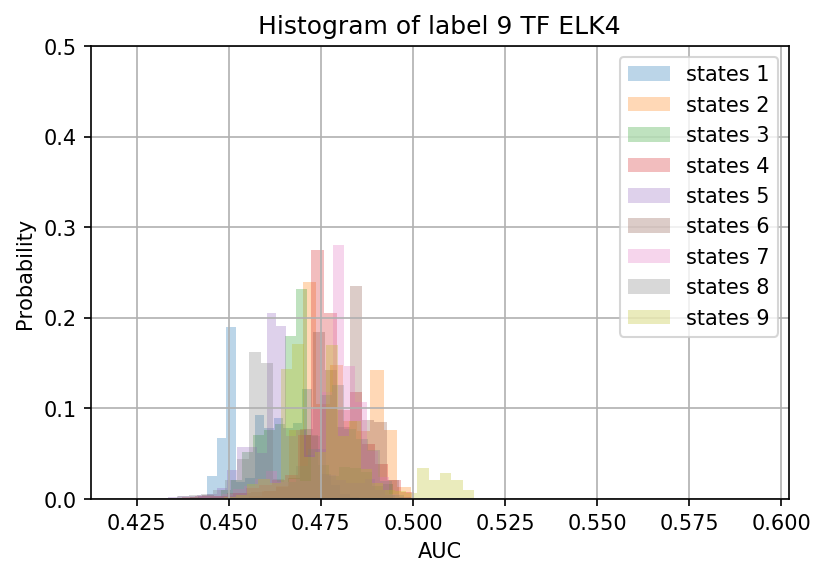

...

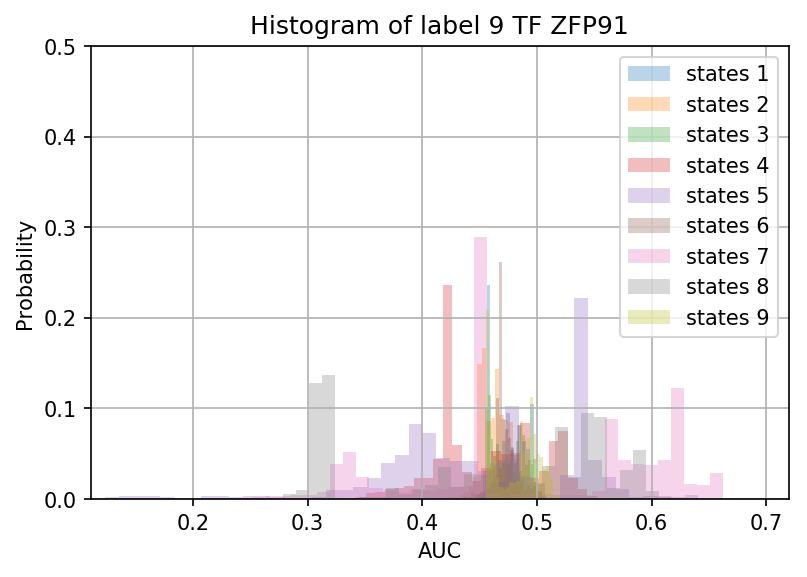

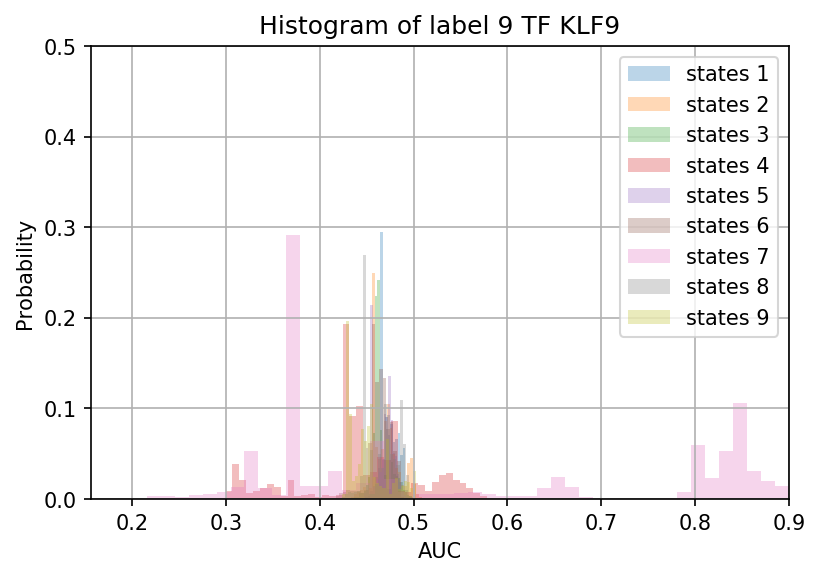

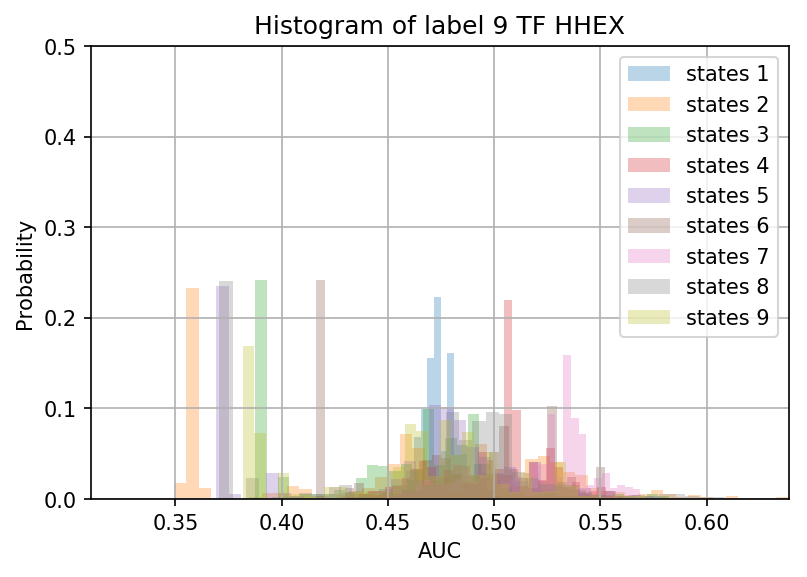

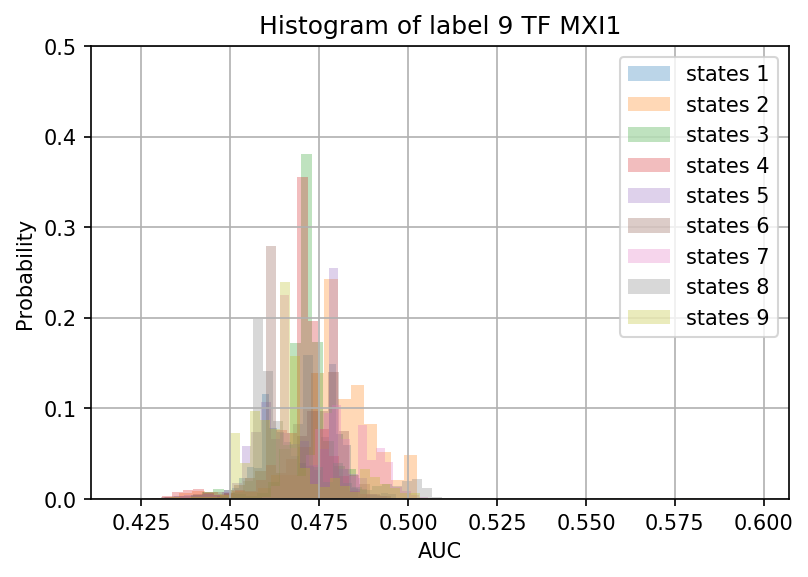

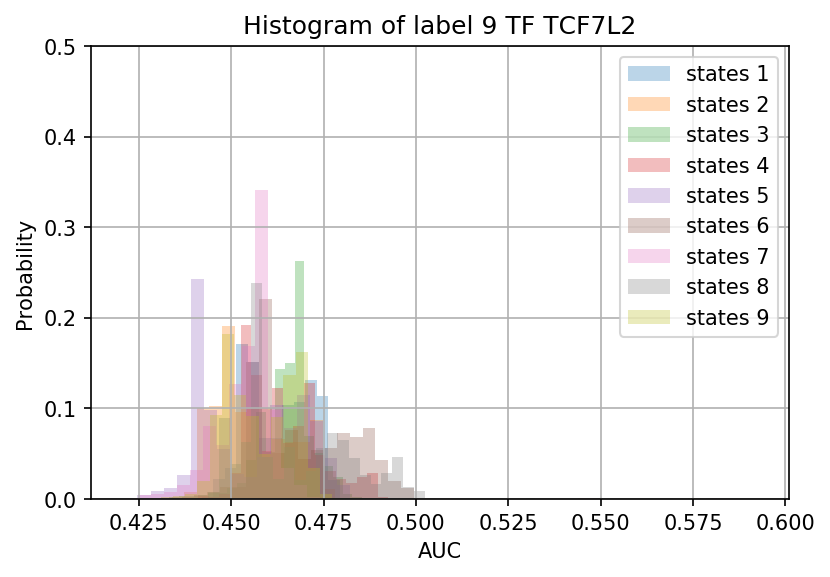

In [7]:
x_min = np.ones(200)
x_max = -1 * np.ones(200)
# find min and max of AUC values in all states.
for label in AUC_dict:
    min_AUC = AUC_dict[label].min(axis = 0)
    max_AUC = AUC_dict[label].max(axis = 0)
    x_min = np.minimum(min_AUC, x_min)
    x_max = np.maximum(max_AUC, x_max)

i = 20
for idx, TF in enumerate(AUC_dict[1].columns):    
#     i -= 1
    for label in AUC_dict:
        AUC_df = AUC_dict[label]      
        x = AUC_df[TF].values.tolist()
        n, bins, patches = plt.hist(x, 50, density = False, alpha = 0.3, 
                                    weights=np.ones(len(x)) / len(x),
                                   label = 'states {}'.format(label))
        plt.xlabel('AUC')
        plt.ylabel('Probability')
        plt.title('Histogram of label {} TF {}'.format(label, TF))
        plt.grid(True)
        plt.xlim(x_min[idx], x_max[idx])
        plt.ylim(0, 0.5)
    plt.legend()
    plt.show()
    
    if i < 0:
        break

# with all targets

In [15]:
p2AUC_dict = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_hepa_monoc_states_all_target'
with open(p2AUC_dict, 'rb') as f:
    AUC_dict = pickle.load(f)
print(AUC_dict.keys())
AUC_dict[1]

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9])


,NCOA2,STAT1,LRRFIP1,HES6,ELK4,NR5A2,ATF6,NR1I3,PROX1,IRF6,...,CXXC1,MBD1,TSHZ1,KDM2A,RELA,ZFP91,KLF9,HHEX,MXI1,TCF7L2
PN14_AAACCCAAGAAATGGG,0.371465,0.374052,0.373339,0.372868,0.381417,0.370092,0.377020,0.375666,0.370947,0.369973,...,0.371305,0.375940,0.381003,0.374342,0.375735,0.370316,0.392155,0.376205,0.374230,0.374382
PN14_AAACCCAAGCTGAGTG,0.372552,0.377150,0.376262,0.375593,0.384205,0.371856,0.379136,0.379007,0.373445,0.373514,...,0.371565,0.378569,0.382273,0.377164,0.376051,0.372338,0.394058,0.380200,0.376543,0.375269
PN14_AAACCCACAACGTTAC,0.372233,0.376506,0.375606,0.374943,0.383556,0.371204,0.378576,0.378272,0.372836,0.372839,...,0.371331,0.377989,0.381883,0.376577,0.375625,0.371739,0.393618,0.379475,0.376001,0.374884
PN14_AAACCCAGTGCAATAA,0.372557,0.377134,0.376248,0.375575,0.384199,0.371843,0.379130,0.379000,0.373418,0.373498,...,0.371548,0.378573,0.382254,0.377156,0.376052,0.372300,0.394044,0.380185,0.376528,0.375267
PN14_AAACCCAGTGCTCCGA,0.372548,0.377036,0.376181,0.375553,0.384149,0.371779,0.379089,0.378979,0.373367,0.373434,...,0.371545,0.378511,0.382225,0.377094,0.375976,0.372245,0.394022,0.380119,0.376481,0.375248
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PHx96_TTTGGTTGTACCCGAC,0.362411,0.356217,0.355576,0.362399,0.362571,0.356002,0.366958,0.350563,0.350824,0.352610,...,0.354992,0.365934,0.366486,0.362674,0.369326,0.352058,0.372294,0.357743,0.364386,0.355199
PHx96_TTTGGTTTCCAGTGTA,0.356624,0.352037,0.353316,0.357179,0.358564,0.350282,0.360638,0.346256,0.345270,0.350086,...,0.346075,0.361575,0.360559,0.359495,0.361478,0.346522,0.367577,0.354611,0.358811,0.347050
PHx96_TTTGGTTTCCATGATG,0.356496,0.352178,0.353567,0.357014,0.358657,0.350063,0.360346,0.345986,0.345044,0.350002,...,0.345800,0.361518,0.360343,0.359356,0.361054,0.346227,0.367255,0.354300,0.358630,0.346641
PHx96_TTTGTTGCAAGCTACT,0.397441,0.398839,0.402577,0.394256,0.397403,0.392322,0.399965,0.390464,0.395953,0.395351,...,0.384250,0.406890,0.405327,0.405816,0.403559,0.389533,0.400957,0.404877,0.397280,0.390828


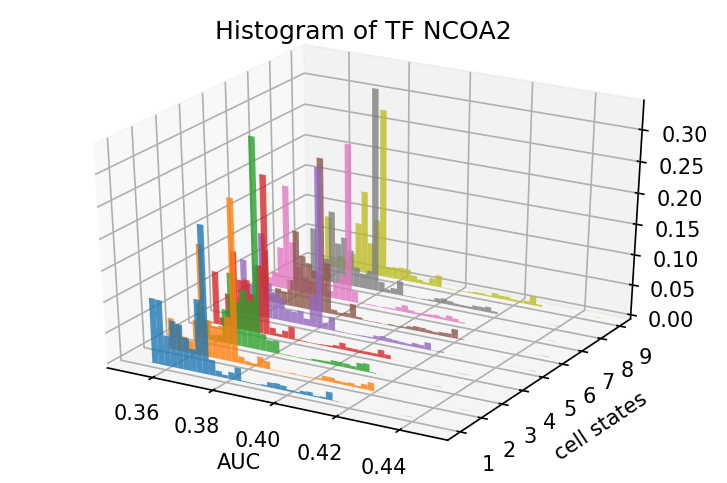

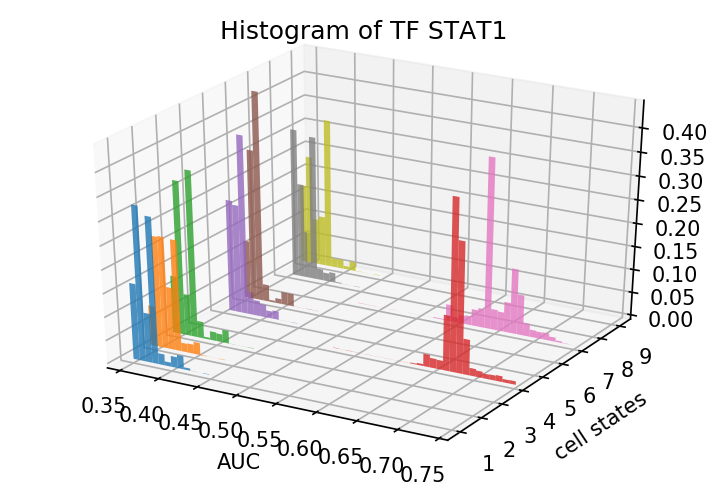

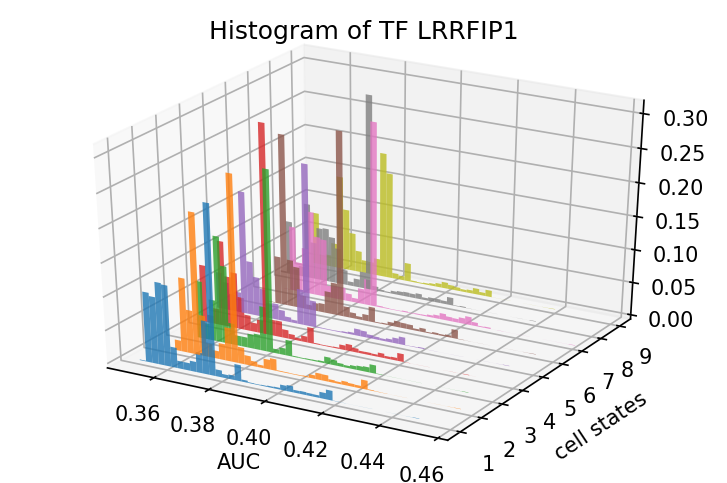

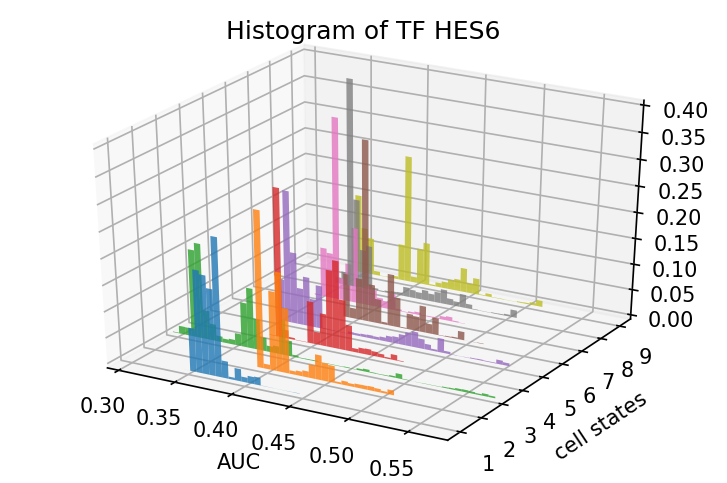

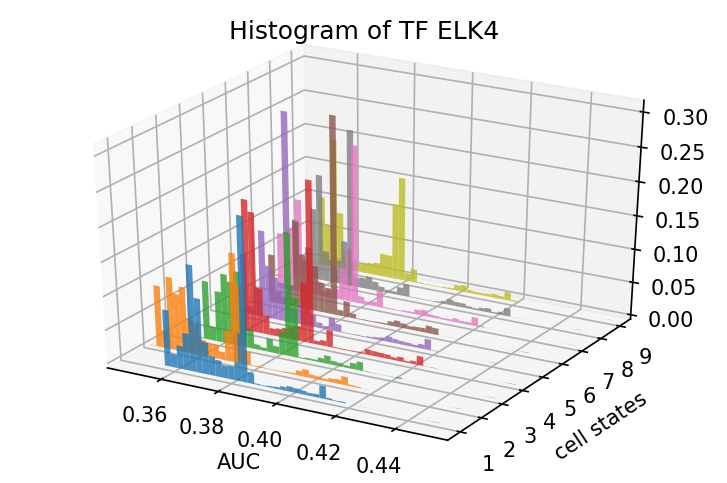

...

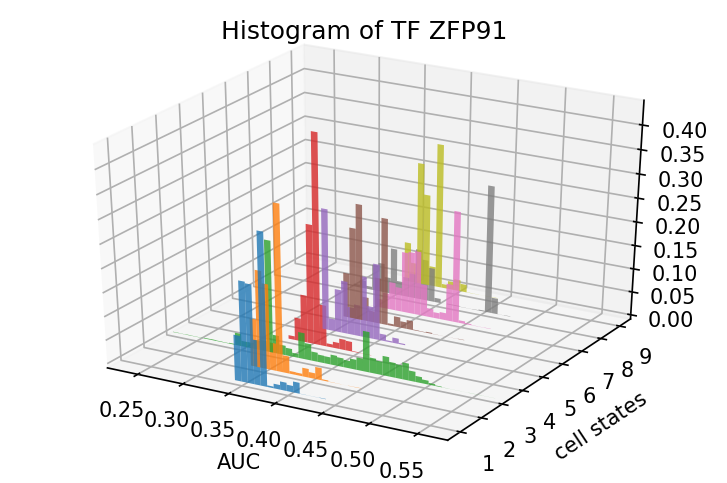

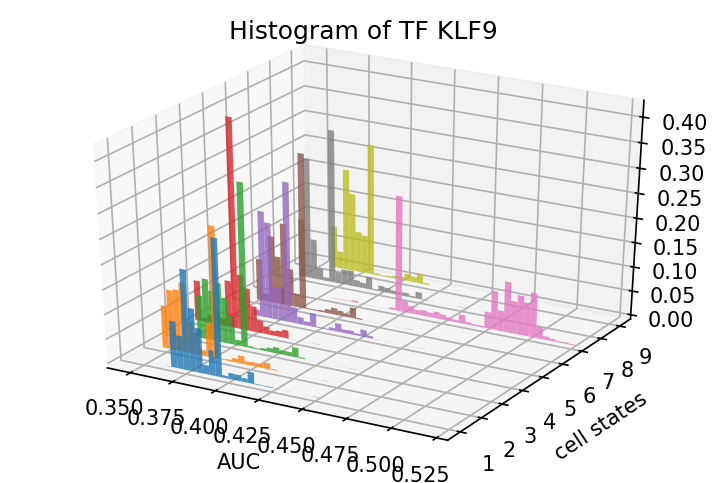

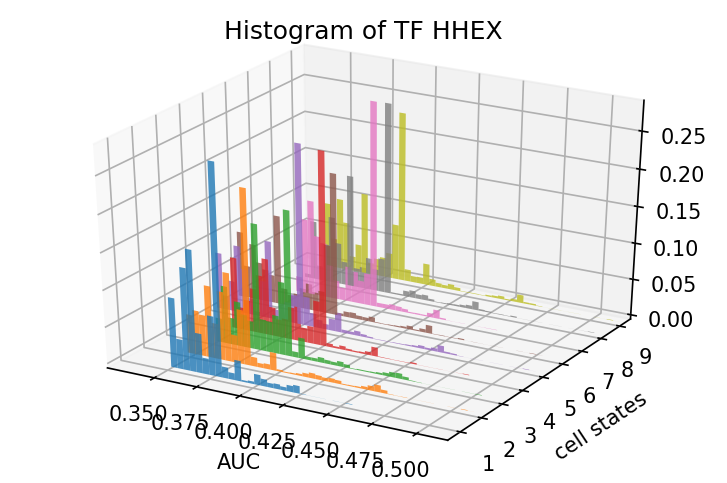

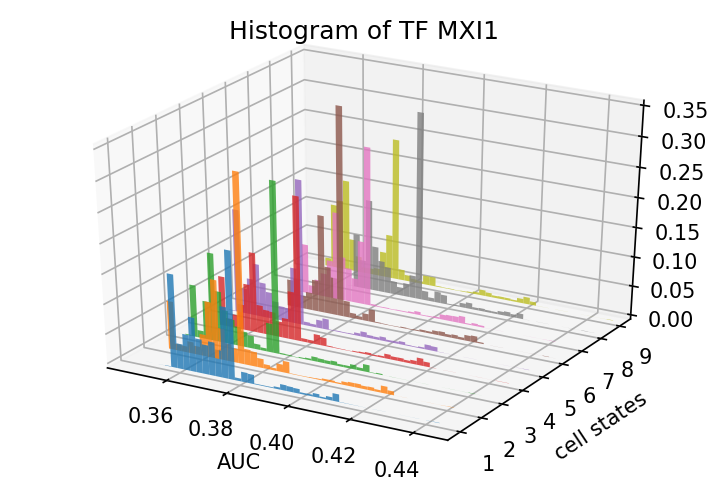

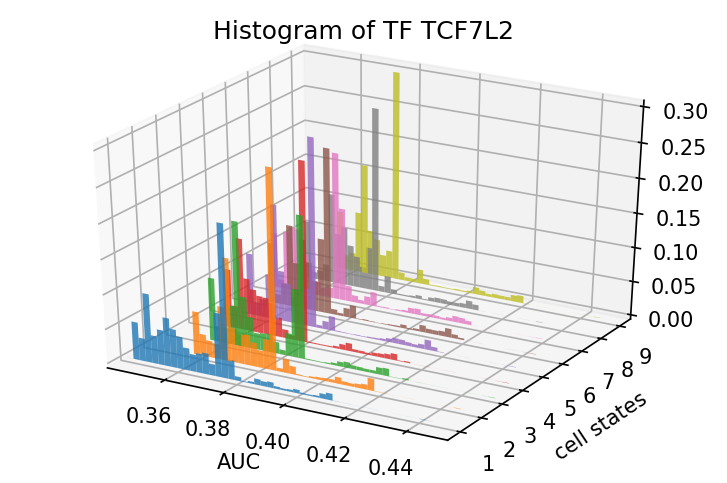

In [65]:
x_min = np.ones(200)
x_max = -1 * np.ones(200)
# find min and max of AUC values in all states.
for label in AUC_dict:
    min_AUC = AUC_dict[label].min(axis = 0)
    max_AUC = AUC_dict[label].max(axis = 0)
    x_min = np.minimum(min_AUC, x_min)
    x_max = np.maximum(max_AUC, x_max)

i = 5
TF_hist_dict = {}
for idx, TF in enumerate(AUC_dict[1].columns):    
#     i -= 1
    TF_hist_dict[TF] = {}
    nbins = 50
    bar_width =  (-x_min[idx] + x_max[idx]) / nbins
    bin_list = np.arange(x_min[idx], x_max[idx] + bar_width, bar_width)
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    label_order = sorted(list(AUC_dict.keys()))

    for label in label_order:
        AUC_df = AUC_dict[label]      
        y = AUC_df[TF].values.tolist()
        
        hist, _ = np.histogram(y, bins = bin_list,
                              weights=np.ones(len(y)) / len(y))
#         xs = (bins[:-1] + bins[1:])/2
        xs = (bin_list[:-1] + bin_list[1:])/2
        legend_name = 'state {}'.format(label)
        
        TF_hist_dict[TF][label] = {
            'hist': hist,
            'xs': xs
        }
        try:
            ax.bar(xs, hist, zs = label, 
                   zdir = 'y',
                   width = bar_width,
                   alpha = 0.8,
                  label = legend_name
                  )
        except:
            print('error in ax.bar')
            continue

    
    ax.set_xlabel('AUC')
    ax.set_xlim(x_min[idx], x_max[idx])
    ax.set_ylabel('cell states')
    ax.set_yticks(label_order)
    ax.set_title('Histogram of TF {}'.format(TF))
#     plt.legend()
    plt.show()
    
    if i < 0:
        break

In [73]:
for TF in TF_hist_dict:
    print('-' * 7)
    xs_old = TF_hist_dict[TF][1]['xs']
    print(xs_old[:3], len(xs_old))
    order_list = sorted(TF_hist_dict[TF].keys())
    for label in order_list:
        xs_new = TF_hist_dict[TF][label]['xs']
#         print(xs_new[:3])
        if not np.array_equal(xs_old, xs_new):
            print(TF)
            print(np.sum(abs(xs_new - xs_old)))

print(len(TF_hist_dict))

-------
[0.34804093 0.3501576  0.35227428] 51
-------
[0.34618433 0.35437805 0.36257176] 51
-------
[0.34647266 0.34878432 0.35109597] 50
-------
[0.29858179 0.30420578 0.30982977] 50
-------
[0.3443672  0.34660074 0.34883429] 50
-------
[0.34443855 0.34666588 0.34889321] 50
-------
[0.34540187 0.3477658  0.35012973] 51
-------
[0.30587818 0.30982407 0.31376996] 51
-------
[0.16500561 0.17122423 0.17744285] 50
-------
[0.34323567 0.34557283 0.34790999] 50
-------
[0.34988475 0.35201687 0.35414898] 50
-------
[0.28772704 0.29488527 0.30204351] 51
-------
[0.34496924 0.3471794  0.34938956] 50
-------
[0.34435228 0.34654685 0.34874141] 51
-------
[0.34400656 0.34636367 0.34872078] 51
-------
[0.34966851 0.35179292 0.35391733] 50
-------
[0.26476873 0.27048243 0.27619613] 51
-------
[0.17493503 0.18427788 0.19362072] 50
-------
[0.34501196 0.34728311 0.34955425] 50
-------
[0.34902161 0.35118685 0.3533521 ] 50
-------
[0.34698856 0.34915793 0.3513273 ] 50
-------
[0.3439211  0.35262421 0.3

In [77]:
TF_divergence_dict = {}
len_of_TF = len(TF_divergence_dict)
for TF in TF_hist_dict:
    num_time_point = len(TF_hist_dict[TF])
    len_of_distn = len(TF_hist_dict[TF][1]['hist'])
    hist_mat = np.zeros((num_time_point, len_of_distn))
    order_list = sorted(list(TF_hist_dict[TF].keys()))
    for label in order_list:
        hist_mat[label - 1, :] = TF_hist_dict[TF][label]['hist']
    TF_divergence_dict[TF] = hist_mat



In [80]:
TF_divergence_dict['NCOA2'].shape

(9, 51)

In [85]:
tmp_mat = TF_divergence_dict['NCOA2']

array([0.00000000e+00, 5.47285464e-05, 5.47285464e-05, 3.28371278e-04,
       1.06337566e-01, 1.05680823e-01, 4.95293345e-02, 7.61821366e-02,
       7.28984238e-02, 5.29225044e-02, 3.65039405e-02, 1.19144046e-01,
       2.38725919e-01, 2.53393170e-02, 9.52276708e-03, 5.14448336e-03,
       1.16024518e-02, 2.12346760e-02, 1.47767075e-03, 1.42294221e-03,
       1.36821366e-03, 2.46278459e-03, 8.26401051e-03, 9.13966725e-03,
       7.55253940e-03, 2.95534151e-03, 2.35332750e-03, 5.36339755e-03,
       6.40323993e-03, 1.91549912e-03, 2.95534151e-03, 1.30801226e-02,
       7.66199650e-04, 2.18914186e-04, 5.47285464e-05, 1.09457093e-04,
       0.00000000e+00, 0.00000000e+00, 5.47285464e-05, 1.09457093e-04,
       5.47285464e-05, 5.47285464e-05, 2.18914186e-04, 4.37828371e-04,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00])

In [91]:
TF_divergence_dict['NCOA2'].max(axis = 0)

array([8.17097198e-02, 1.48314361e-02, 2.52298599e-02, 8.73467601e-02,
       1.72285464e-01, 1.05680823e-01, 1.26806042e-01, 1.38408494e-01,
       1.80713660e-01, 1.26641856e-01, 1.36876095e-01, 2.58154553e-01,
       2.38725919e-01, 3.38386602e-01, 2.57716725e-01, 3.29630035e-01,
       2.60453152e-01, 2.12346760e-02, 2.35332750e-02, 2.34785464e-02,
       3.99518389e-03, 1.24233800e-02, 1.95928196e-02, 1.16024518e-02,
       7.55253940e-03, 7.55253940e-03, 8.70183888e-03, 7.93563923e-03,
       7.88091068e-03, 1.22591944e-02, 1.34632224e-02, 1.30801226e-02,
       6.95052539e-03, 1.18760946e-02, 1.52145359e-02, 3.11952715e-03,
       5.08975482e-03, 1.53239930e-02, 3.22898424e-03, 1.09457093e-04,
       1.64185639e-04, 5.47285464e-04, 3.28371278e-04, 4.37828371e-04,
       4.92556918e-04, 1.64185639e-04, 5.47285464e-04, 6.02014011e-04,
       4.92556918e-04, 6.02014011e-04, 0.00000000e+00])

------
# Debugging

In [ ]:
df_tmp = pd.DataFrame(data = np.random.rand(3, 4), columns = ['a', 'b', 'c', 'd'], index = ['x', 'y', 'z'])

df_test = df_tmp.reset_index(drop = True)
print(df_tmp)
print(df_test)
for row in df_test.iterrows():
    print(type(row[0]))
    print(row[1])

df_test.loc[1] = 0
test_seris = pd.Series([1, 2], index = ['a', 'c'])
df_test.loc[2] = test_seris
df_test.fillna(0)

df_test.sort_values(axis = 1, by = 0, ascending = False)

In [ ]:
np.zeros(3)
df_test.loc[1] = [4, 0, 0, 0]

In [ ]:
a = [1, 0, 0, 0]
np.sum([np.sum(df_test.fillna(0).loc[1].values[:x+1]) for x in range(4)]) / np.sum(df_test.fillna(0).loc[1]) / 4

In [ ]:
df_test.fillna(0)

In [ ]:
# test if notebook keep running after closing window, detach from tmux, and close terminal.
import time

def stopwatch(seconds):
    start = time.time()
    # time.time() returns the number of seconds since the unix epoch.
    # To find the time since the start of the function, we get the start
    # value, then subtract the start from all following values.
    time.clock()    
    # When you first call time.clock(), it just starts measuring
    # process time. There is no point assigning it to a variable, or
    # subtracting the first value of time.clock() from anything.
    # Read the documentation for more details.
    elapsed = 0
    while elapsed < seconds:
        elapsed = time.time() - start
        print("loop cycle time: %f, seconds count: %02d" % (time.clock() , elapsed)) 
        time.sleep(1)  
        # You were sleeping in your original code, so I've stuck this in here...
        # You'll notice that the process time is almost nothing.
        # This is because we are spending most of the time sleeping,
        # which doesn't count as process time.
        # For funsies, try removing "time.sleep()", and see what happens.
        # It should still run for the correct number of seconds,
        # but it will run a lot more times, and the process time will
        # ultimately be a lot more. 
        # On my machine, it ran the loop 2605326 times in 20 seconds.
        # Obviously it won't run it more than 20 times if you use time.sleep(1)

stopwatch(300)

### Conclusion: output from code will not be updated and stored.

# But the code will continue running and saved the variable.
-----

In [ ]:
from time import sleep
file = open("jupyter_tab_close_test", "w")
file.close()
i = 0
while i < 300:
    print("{}\n".format(i))
    i +=1
    with open("jupyter_tab_close_test", "a") as f:
        f.write("{}\n".format(i))
    sleep(1)

In [ ]:
print(i)

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
nbins = 50
for c, z in zip(['r', 'g', 'b', 'y'], [30, 20, 10, 0]):
    ys = np.random.normal(loc=10, scale=10, size=2000)

    hist, bins = np.histogram(ys, bins=nbins)
    xs = (bins[:-1] + bins[1:])/2

    ax.bar(xs, hist, zs=z, zdir='y', color=c, ec=c, alpha=0.8)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_yticks([30, 20, 10, 0])
ax.set_zlabel('Z')

plt.show()